In [1]:
import DyLoPro as dlp
import pandas as pd

 read in the event log and converting some columns to the required dtype.

In [2]:
data = pd.read_csv(r'C:\Users\Levi Tu\thesis data\DomesticDeclarations.csv')
DD_log = data.drop(data.columns[0],axis = 1)
DD_log.head(3)

,id,org:resource,concept:name,time:timestamp,org:role,case:id,case:concept:name,case:BudgetNumber,case:DeclarationNumber,case:Amount
0,st_step 86794_0,STAFF MEMBER,Declaration SUBMITTED by EMPLOYEE,2017-01-09 09:49:50+00:00,EMPLOYEE,declaration 86791,declaration 86791,budget 86566,declaration number 86792,26.851205
1,st_step 86793_0,STAFF MEMBER,Declaration FINAL_APPROVED by SUPERVISOR,2017-01-09 11:27:48+00:00,SUPERVISOR,declaration 86791,declaration 86791,budget 86566,declaration number 86792,26.851205
2,dd_declaration 86791_19,SYSTEM,Request Payment,2017-01-10 09:34:44+00:00,UNDEFINED,declaration 86791,declaration 86791,budget 86566,declaration number 86792,26.851205


In [3]:
DD_log['time:timestamp'] = pd.to_datetime(DD_log['time:timestamp'], format='mixed').dt.tz_convert('UTC')

Specifying the available features. The DomesticDeclarations event log contains no case outcome and no numeric event featuers.

In [4]:
categorical_casefeatures = ['case:id', 'case:DeclarationNumber']
categorical_eventfeatures = ['id','org:resource', 'concept:name', 'org:role']
numeric_casefeatures = ['case:Amount']

Initializing a DynamicLogPlots instance as DD_plots. 
NOTE: We only want to analyze the trends for cases starting from 2017

In [5]:
DD_plots = dlp.DynamicLogPlots(DD_log, case_id_key = 'case:concept:name', activity_key = 'concept:name', 
                                   timestamp_key = 'time:timestamp', categorical_casefeatures = categorical_casefeatures, 
                                   categorical_eventfeatures = categorical_eventfeatures, 
                                   numerical_casefeatures = numeric_casefeatures, start_date = "01/01/2017")

Preprocessing the data...


100%|██████████| 56437/56437 [00:00<00:00, 1252202.92it/s]


Retrieving the dataframe containing the activity sequences (and counts) of the top 10 most frequently occurring variants.

In [6]:
var_df = DD_plots.get_var_df(max_k = 10, counts = True)
print(var_df.to_string())

                                                                                                                                                                                                                                                                                                                   variant  variant count
variant number                                                                                                                                                                                                                                                                                                                           
1                                                                                                                                                                  (Declaration SUBMITTED by EMPLOYEE, Declaration APPROVED by ADMINISTRATION, Declaration FINAL_APPROVED by SUPERVISOR, Request Payment, Payment Handled)           4618
2         

Representation type : Throughput Time

Computing additional weekly Throughput Time aggregations for each of the 10 most frequently occurring variants: 100%|██████████| 10/10 [00:00<00:00, 128.80it/s]


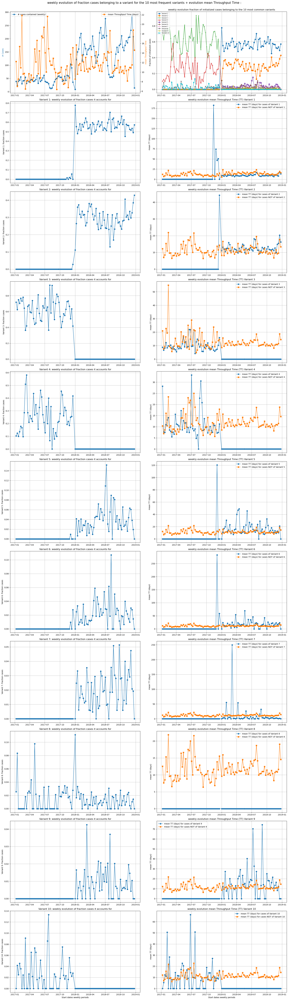

In [7]:
DD_plots.topK_variants_evol(max_k = 10, plt_type = 'type_tt', xtr_outlier_rem = False)

2. Directly-Follows-Relations (DFRs)  
Analysis of 10 fluent DFRs

In [8]:
dfr_df = DD_plots.get_DFR_df(max_k = 10, counts = True)
print(dfr_df.to_string())

                                                                                           DFR  DFR count
DFR number                                                                                               
1                                  (Declaration FINAL_APPROVED by SUPERVISOR, Request Payment)      10038
2                                                           (Request Payment, Payment Handled)      10037
3                  (Declaration SUBMITTED by EMPLOYEE, Declaration APPROVED by ADMINISTRATION)       8202
4           (Declaration APPROVED by ADMINISTRATION, Declaration FINAL_APPROVED by SUPERVISOR)       5133
5               (Declaration APPROVED by ADMINISTRATION, Declaration APPROVED by BUDGET OWNER)       2820
6             (Declaration APPROVED by BUDGET OWNER, Declaration FINAL_APPROVED by SUPERVISOR)       2788
7                (Declaration SUBMITTED by EMPLOYEE, Declaration FINAL_APPROVED by SUPERVISOR)       1536
8                        (Declaration REJECTED

2.1 Representation type : Throughput Time (TT)

Computing additional weekly Throughput Time aggregations for each of the 10 most frequently occurring DFRs: 100%|██████████| 10/10 [00:00<00:00, 44.89it/s]


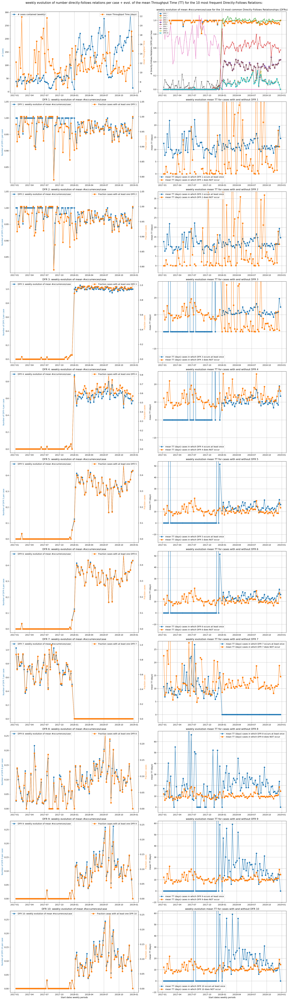

In [13]:
DD_plots.topK_dfr_evol(plt_type = 'type_tt')

2.2 Representation type : Case Length (NEPC)

Computing additional weekly aggregations of the amount of events per case for each of the 10 most frequently occurring DFRs: 100%|██████████| 10/10 [00:00<00:00, 45.16it/s]


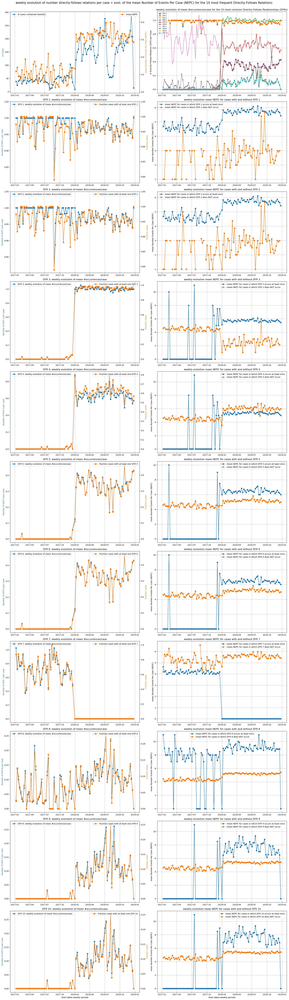

In [16]:
DD_plots.topK_dfr_evol(plt_type = 'type_events_case')

2.3 Representation type : DFR Performance

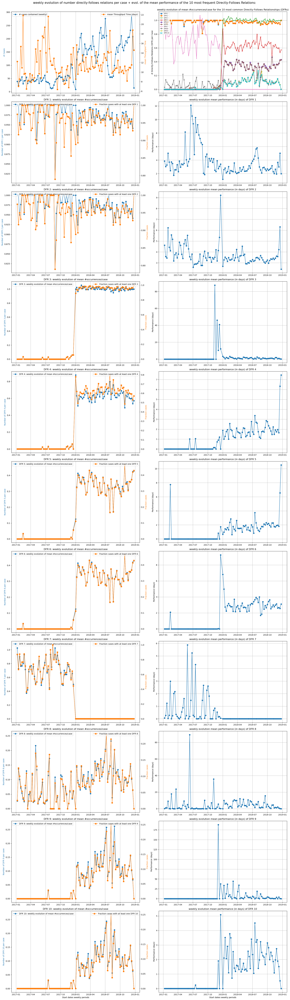

In [17]:
DD_plots.topK_dfr_evol(plt_type = 'type_dfr_performance', xtr_outlier_rem = False)

3. Categorical Case Features

In [13]:
categorical_casefeatures

['case:id', 'case:DeclarationNumber']

3.1 Categorical Case Features: 'case:id'  
3.1.1 'case:id' - Representation type: Throughput Time (TT)

Computing additional weekly aggregations of the Throughput Time for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 57.93it/s]


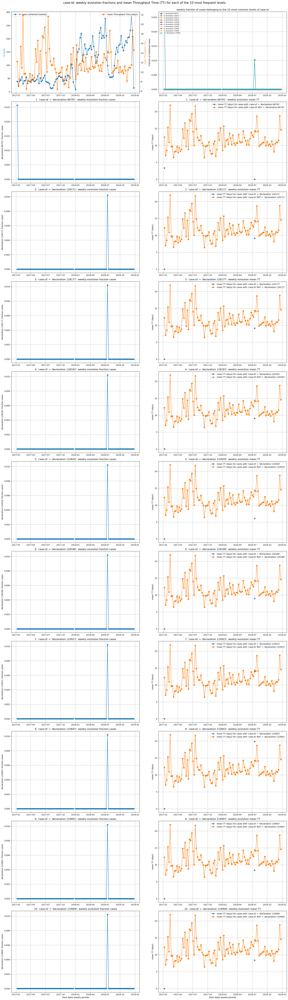

In [21]:
DD_plots.topK_categorical_caseftr_evol(case_feature = 'case:id', plt_type = 'type_tt', xtr_outlier_rem = False)

3.1.2 'case:id' - Representation type: Throughput Time (NEPC) 

Computing additional weekly aggregations of the Number of Events Per Case (NEPC) for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 45.22it/s]


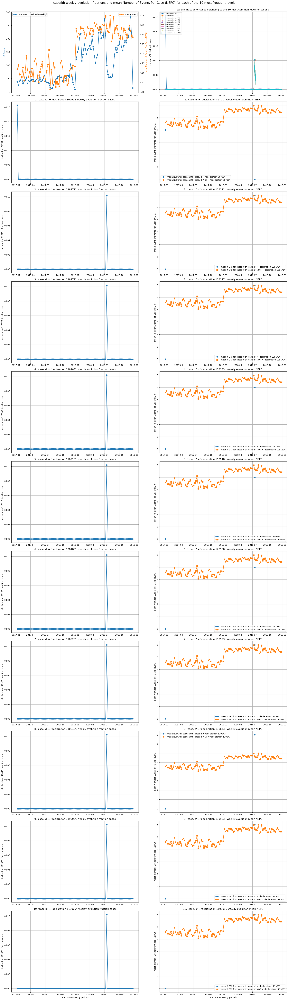

In [16]:
DD_plots.topK_categorical_caseftr_evol(case_feature = 'case:id', plt_type = 'type_events_case', xtr_outlier_rem = False)

3.2 Categorical Case Features: 'case:DeclarationNumber'  
3.2.1 'case:DeclarationNumber' - Representation type: Throughput Time (TT)

Computing additional weekly aggregations of the Throughput Time for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 48.35it/s]


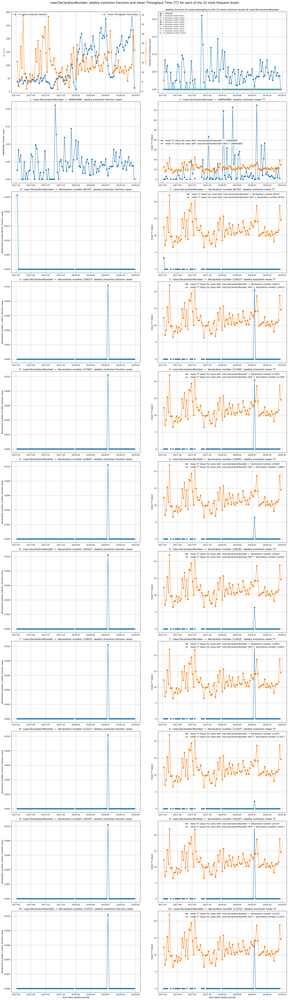

In [22]:
DD_plots.topK_categorical_caseftr_evol(case_feature = 'case:DeclarationNumber', plt_type = 'type_tt', xtr_outlier_rem = False)

3.2.2 'case:DeclarationNumber' - Representation type: Case Length (NEPC)

Computing additional weekly aggregations of the Number of Events Per Case (NEPC) for each of the 10 most frequently occurring levels: 100%|██████████| 10/10 [00:00<00:00, 39.49it/s]


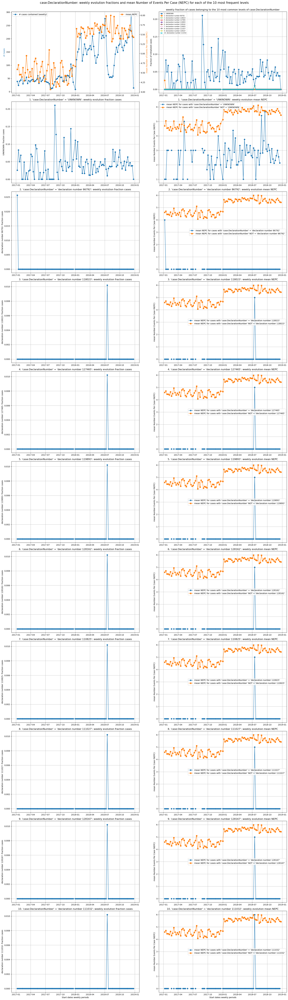

In [15]:
DD_plots.topK_categorical_caseftr_evol(case_feature = 'case:DeclarationNumber', plt_type = 'type_events_case', xtr_outlier_rem = False)

4. Categorical Event Features  
4.1 org:role  
4.1.1 'org:role' - Representation type: Throughput Time (TT)

Computing the weekly aggregations for each of the 7 most frequently occurring levels of categorical event feature 'org:role': 100%|██████████| 7/7 [00:00<00:00, 35.86it/s]


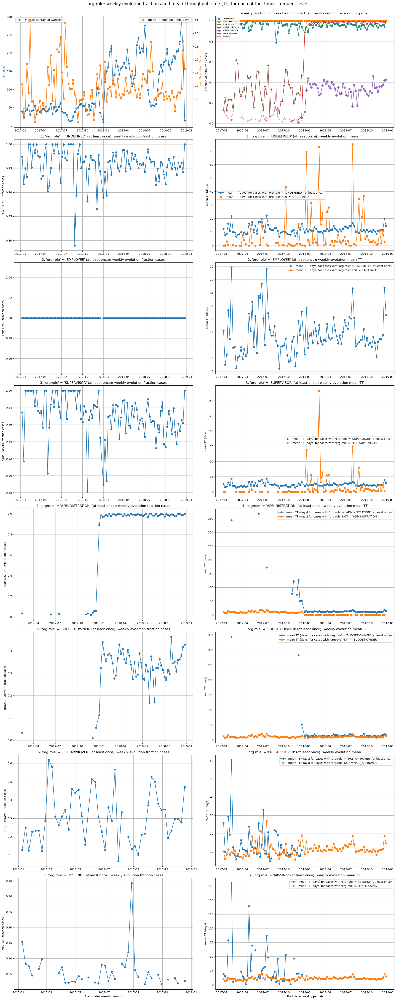

In [9]:
DD_plots.topK_categorical_eventftr_evol(event_feature='org:role', plt_type = 'type_tt', xtr_outlier_rem = False)

4.1.2 'org:role' - Representation type: Case Length (NEPC)

Computing the weekly aggregations for each of the 7 most frequently occurring levels of categorical event feature 'org:role': 100%|██████████| 7/7 [00:00<00:00, 47.46it/s]


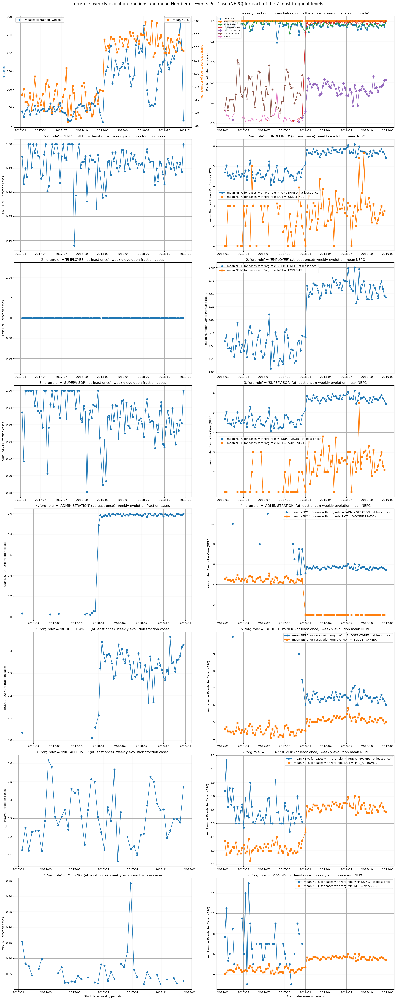

In [10]:
DD_plots.topK_categorical_eventftr_evol(event_feature='org:role', plt_type = 'type_events_case', xtr_outlier_rem = False)

4.2. Categorical Event Feature: 'concept:name'  
    4.2.1 'concept:name' - Representation type: Throughput Time (TT)

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 25.83it/s]


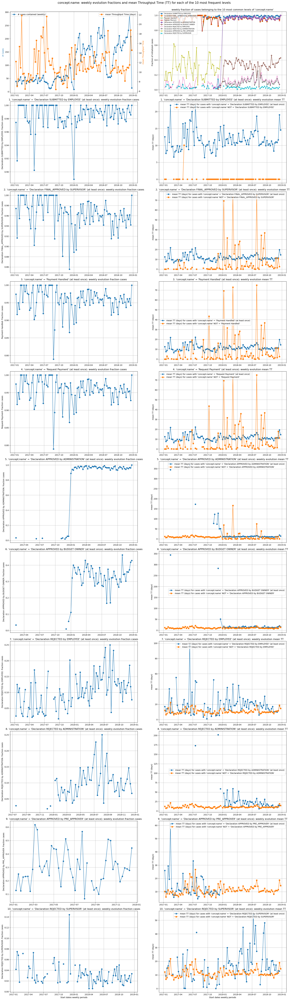

In [24]:
DD_plots.topK_categorical_eventftr_evol(event_feature='concept:name', plt_type = 'type_tt', xtr_outlier_rem = False)

4.2.2 'concept:name' - Representation type: Case Length (NEPC)

Computing the weekly aggregations for each of the 10 most frequently occurring levels of categorical event feature 'concept:name': 100%|██████████| 10/10 [00:00<00:00, 18.74it/s]


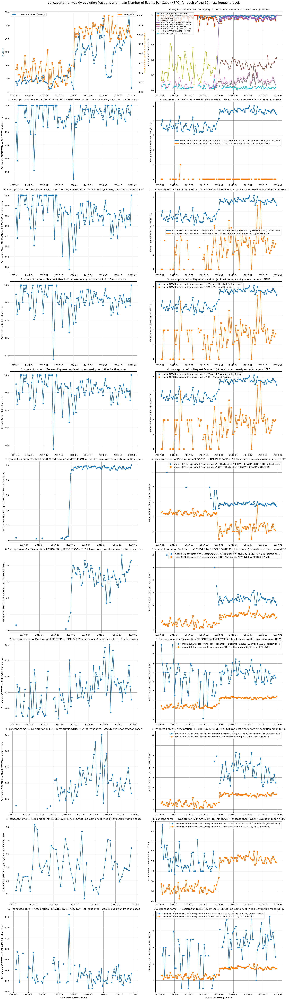

In [19]:
DD_plots.topK_categorical_eventftr_evol(event_feature='concept:name', plt_type = 'type_events_case', xtr_outlier_rem = False)

5. Numerical Case Features  
5.1.1 Numerical Case Features - Representation type: Throughput Time (TT)

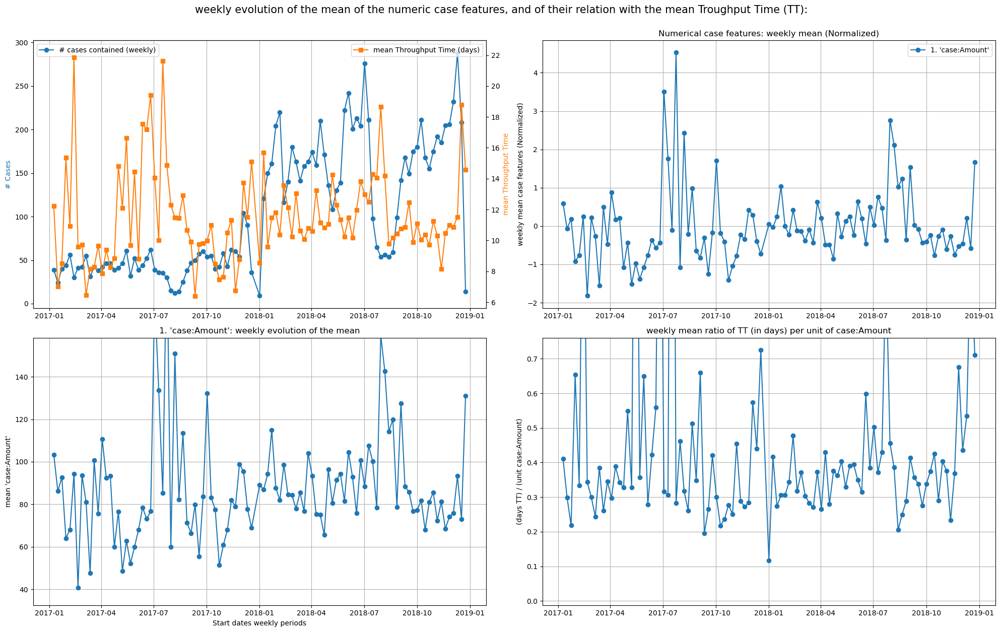

In [21]:
DD_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_tt')

5.1.2 'case:Amount' - Representation type: Case Length (NEPC)

Computing the additional weekly NEPC aggregations for each of the 1 given numerical case features: 100%|██████████| 1/1 [00:00<00:00, 29.46it/s]


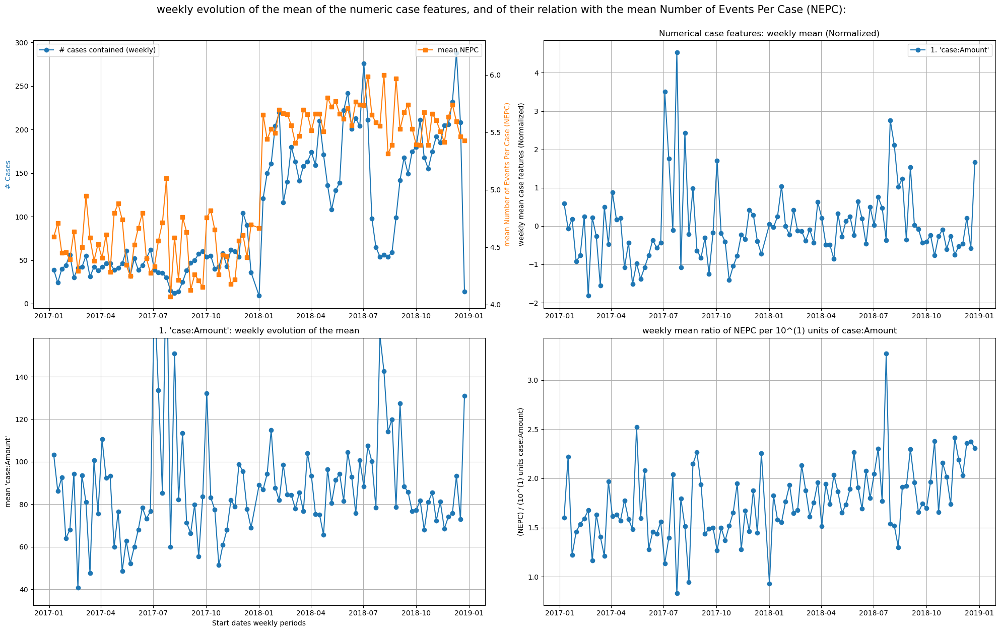

In [22]:
DD_plots.num_casefts_evol(numeric_case_list = numeric_casefeatures, plt_type = 'type_events_case')